In [1]:
#@title Установка модуля УИИ
!rm -rf sample_data

import seaborn as sns
import random
import os
import numpy as np
import tensorflow as tf
import gdown
from IPython.display import clear_output

!pip -q install python-Levenshtein

# Установочные параметры
sns.set(style='darkgrid') 
seed_value = 12
random.seed(seed_value)
np.random.seed(seed_value)
tf.random.set_seed(seed_value)

# Загрузка модуля
gdown.download('https://raw.githubusercontent.com/Alexsandr-Gorbachev/dl_intensive/main/computer_vision/intensivedaythree.py', None, quiet=True)
gdown.download('https://raw.githubusercontent.com/Alexsandr-Gorbachev/dl_intensive/main/computer_vision/check_for_errors.py', None, quiet=True)
gdown.download('https://raw.githubusercontent.com/Alexsandr-Gorbachev/dl_intensive/main/computer_vision/dataset.py', None, quiet=True)
gdown.download('https://raw.githubusercontent.com/Alexsandr-Gorbachev/dl_intensive/main/computer_vision/model.py', None, quiet=True)
gdown.download('https://raw.githubusercontent.com/Alexsandr-Gorbachev/dl_intensive/main/computer_vision/traide.py', None, quiet=True)
gdown.download('https://github.com/Alexsandr-Gorbachev/dl_intensive/blob/main/computer_vision/segmentation.py', None, quiet=True)
gdown.download('https://raw.githubusercontent.com/Alexsandr-Gorbachev/dl_intensive/main/computer_vision/home.py', None, quiet=True)

import intensivedaythree

demo_ai = intensivedaythree.TerraIntensive()
clear_output(wait=True)

     |████████████████████████████████| 170 kB 5.0 MB/s 
     |████████████████████████████████| 2.2 MB 50.8 MB/s 


## **Трейдинг с помощью нейронных сетей на базах компаний Яндекс, Газпром и полиметаллах**

In [3]:
# Загрузка датасета
demo_ai.load_dataset('Трейдинг')

Загрузка датасета Ok
Ифно:
    Вы скачали базу с данными по акциям трех российских компаний: Яндекс, Газпром и полиметаллы


In [4]:
# Создание обучающей и проверочной выборок
company='Полиметаллы'    # Компания  
days_for_analysis = 10   # Количество анализируемых дней
predict_period = 1       # На сколько дней предсказываем

demo_ai.create_sets(
    company,
    days_for_analysis,
    predict_period,
    )

Формирование выборок: Ok


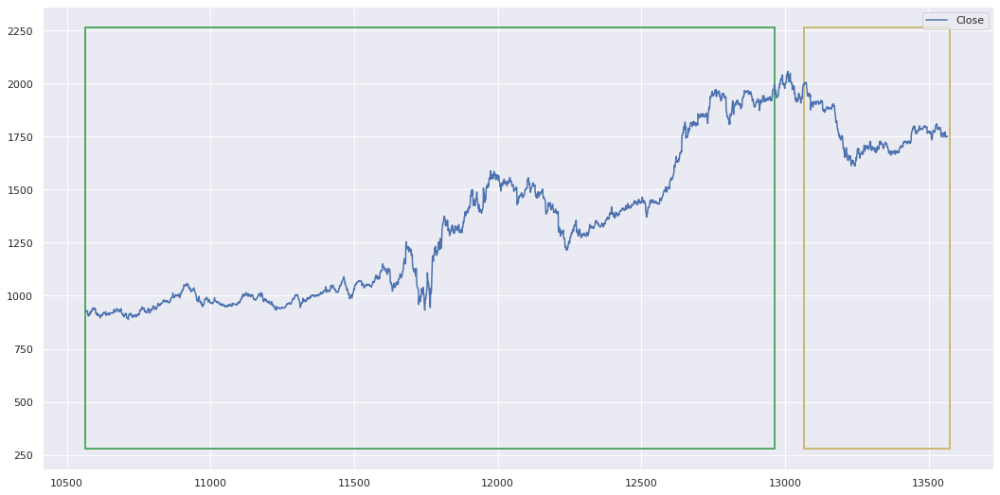

In [5]:
# показываем пример графика закрытия акций
demo_ai.samples()

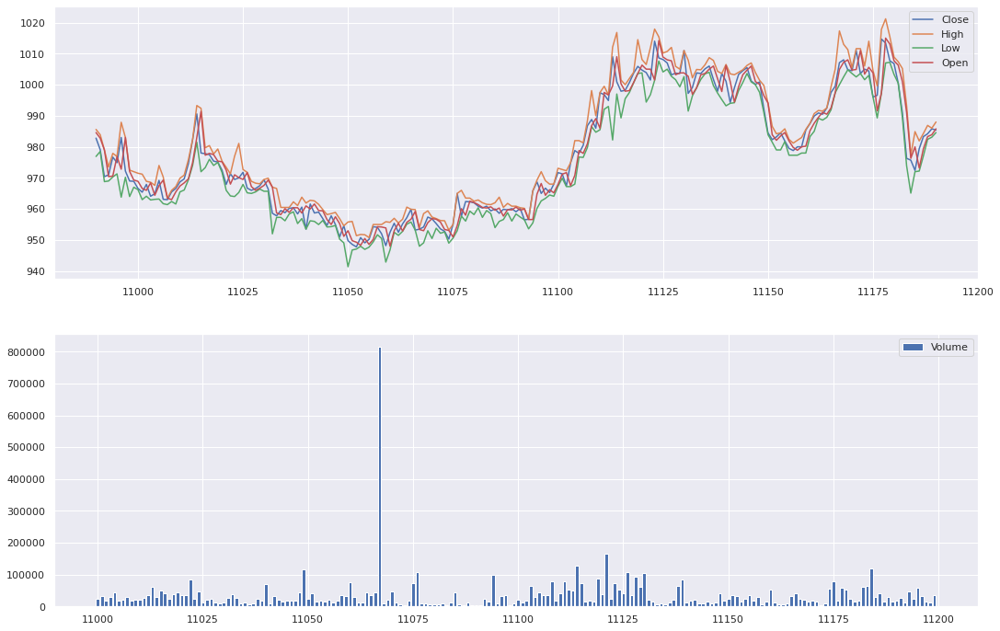

In [6]:
# показываем пример графика закрытия акций
demo_ai.samples(begin=11000, end=11200)

In [7]:
# Задание слоев нейронной сети
layers = f'Выравнивающий\
 Полносвязный-700\
 Полносвязный-3'

# Создание модели нейронной сети
demo_ai.create_model(layers)

Создание модели нейронной сети Ok


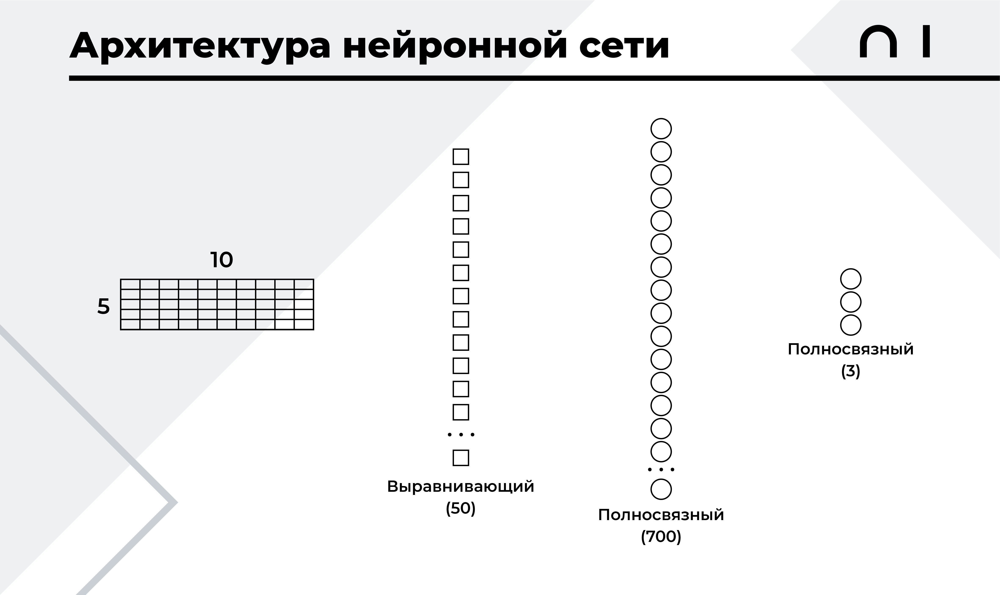

Эпоха №1    Время обучения: 2.76c   Точность на обучающей выборке: 58.37%    Точность на проверочной выборке: 69.66%
Эпоха №2    Время обучения: 0.18c   Точность на обучающей выборке: 70.75%    Точность на проверочной выборке: 66.1%
Эпоха №3    Время обучения: 0.14c   Точность на обучающей выборке: 75.31%    Точность на проверочной выборке: 58.47%
Эпоха №4    Время обучения: 0.15c   Точность на обучающей выборке: 75.69%    Точность на проверочной выборке: 71.02%
Эпоха №5    Время обучения: 0.14c   Точность на обучающей выборке: 79.41%    Точность на проверочной выборке: 68.47%
Эпоха №6    Время обучения: 0.14c   Точность на обучающей выборке: 82.8%     Точность на проверочной выборке: 75.25%
Эпоха №7    Время обучения: 0.14c   Точность на обучающей выборке: 80.79%    Точность на проверочной выборке: 75.76%
Эпоха №8    Время обучения: 0.13c   Точность на обучающей выборке: 83.18%    Точность на проверочной выборке: 71.19%
Эпоха №9    Время обучения: 0.15c   Точность на обучающей выборке

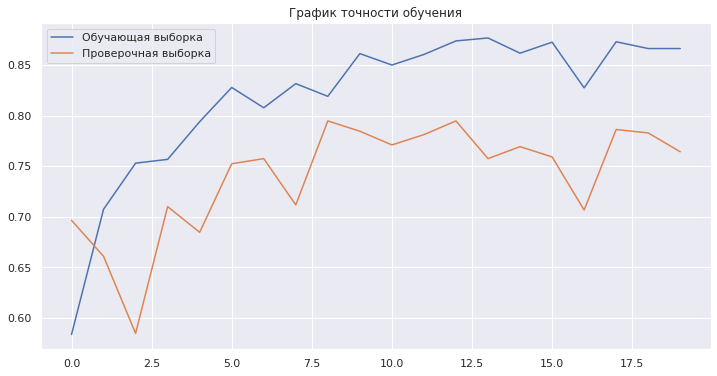

In [8]:
# Обучение нейронной сети
demo_ai.train_model(epochs=20)

Тестрирование модели:   0%|                                                                                   …

1/1 [==============================] - 0s 19ms/step
Результат теста:
  * Количество отсчетов: 590
  * Правильных предсказаний: 469
  * Ошибочных предсказаний:  121

  * Точность предсказаний: 79.49%
Примеры распознавания

1/1 [==============================] - 0s 17ms/step
________________________________________
Тест №1
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2035.5
Цена через 1 интервал(а): 2009.9


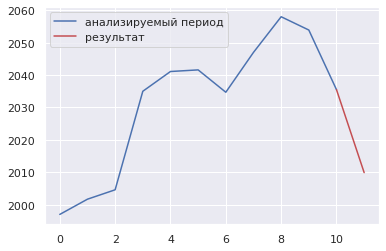

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №2
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2009.9
Цена через 1 интервал(а): 2010.9


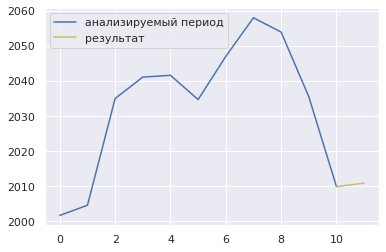

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №3
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2035.1
Цена через 1 интервал(а): 2035.1


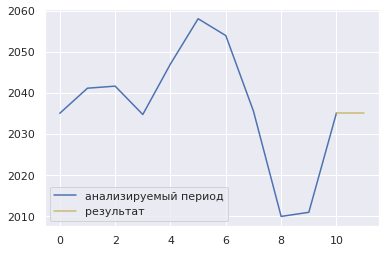

1/1 [==============================] - 0s 17ms/step
________________________________________
Тест №4
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2002.0
Цена через 1 интервал(а): 1978.5


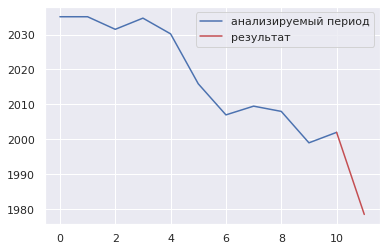

In [9]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model(    
    predict_period,
    days_for_analysis
    )

Производится симуляция торговой сессии
1/1 [==============================] - 0s 16ms/step
Стартовый капитал: 100000
Прирост после торгов: + 43780
Итого: 143780


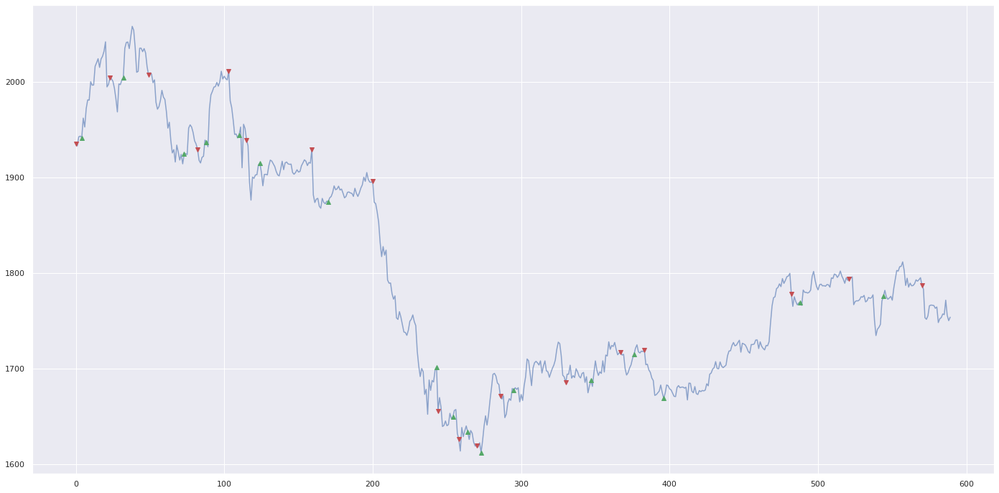

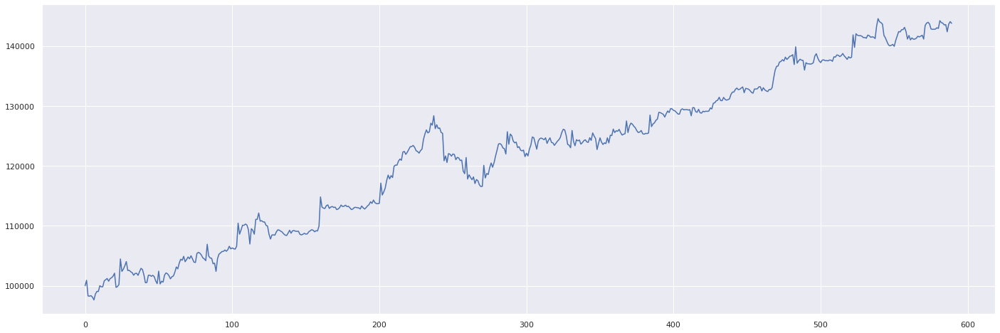

In [10]:
# Симуляция торговой сессии
demo_ai.traiding()

<h2><b>Проводим серию экспериментов</b></h2>

**Эксперимент №1**

Эпоха №1    Время обучения: 0.6c    Точность на обучающей выборке: 54.98%    Точность на проверочной выборке: 62.88%
Эпоха №2    Время обучения: 0.14c   Точность на обучающей выборке: 65.31%    Точность на проверочной выборке: 69.49%
Эпоха №3    Время обучения: 0.17c   Точность на обучающей выборке: 71.26%    Точность на проверочной выборке: 67.8%
Эпоха №4    Время обучения: 0.15c   Точность на обучающей выборке: 75.94%    Точность на проверочной выборке: 71.02%
Эпоха №5    Время обучения: 0.14c   Точность на обучающей выборке: 78.87%    Точность на проверочной выборке: 72.37%
Эпоха №6    Время обучения: 0.14c   Точность на обучающей выборке: 82.8%     Точность на проверочной выборке: 77.97%
Эпоха №7    Время обучения: 0.14c   Точность на обучающей выборке: 82.64%    Точность на проверочной выборке: 75.08%
Эпоха №8    Время обучения: 0.13c   Точность на обучающей выборке: 83.51%    Точность на проверочной выборке: 68.14%
Эпоха №9    Время обучения: 0.14c   Точность на обучающей выборке

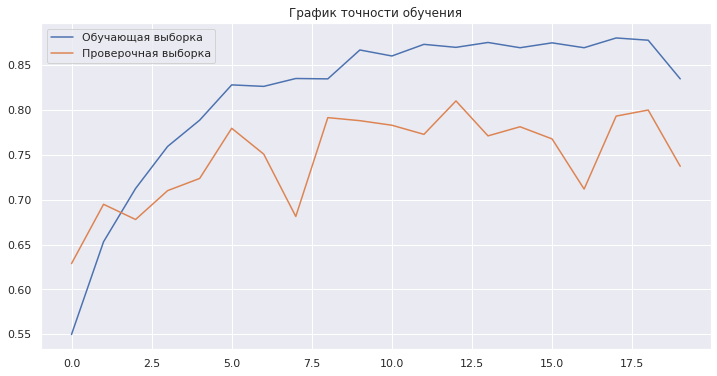

Тестрирование модели:   0%|                                                                                   …

1/1 [==============================] - 0s 16ms/step
Результат теста:
  * Количество отсчетов: 590
  * Правильных предсказаний: 478
  * Ошибочных предсказаний:  112

  * Точность предсказаний: 81.02%
Примеры распознавания

1/1 [==============================] - 0s 16ms/step
________________________________________
Тест №1
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2035.5
Цена через 1 интервал(а): 2009.9


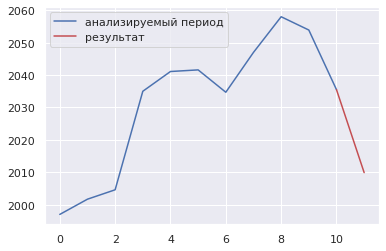

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №2
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2031.5
Цена через 1 интервал(а): 2034.7


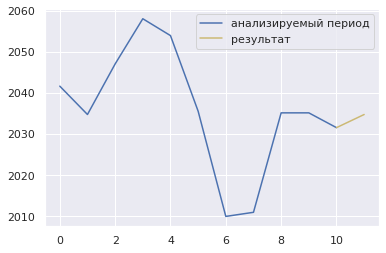

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №3
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2034.7
Цена через 1 интервал(а): 2030.2


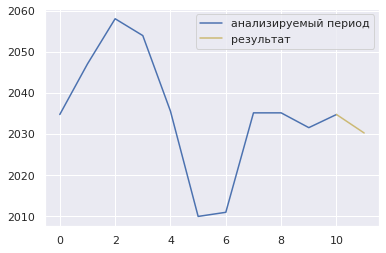

1/1 [==============================] - 0s 19ms/step
________________________________________
Тест №4
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2002.0
Цена через 1 интервал(а): 1978.5


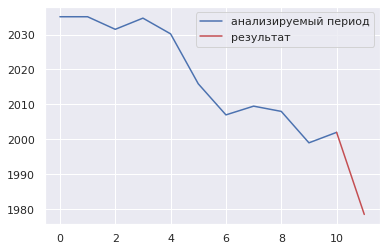

Производится симуляция торговой сессии
1/1 [==============================] - 0s 17ms/step
Стартовый капитал: 100000
Прирост после торгов: + 61585
Итого: 161585


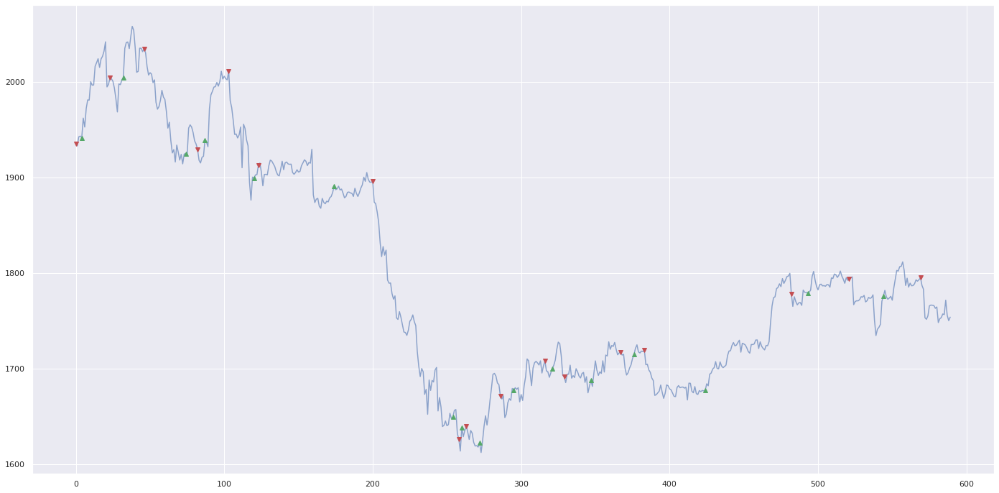

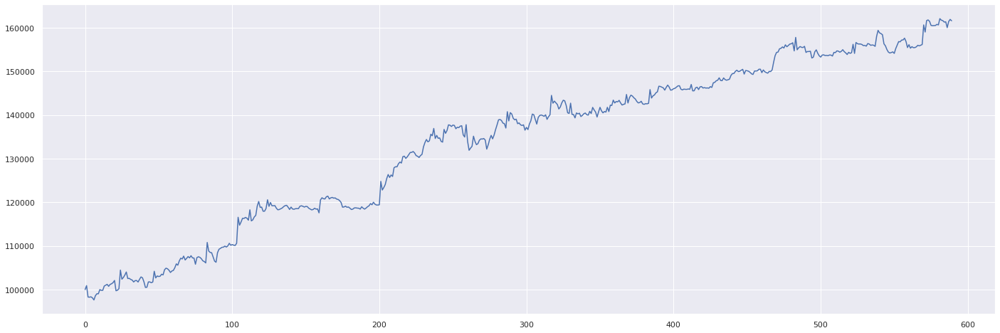

In [11]:
# Задание слоев нейронной сети
layers = f'Выравнивающий\
 Полносвязный-2000\
 Полносвязный-3'

# Создание модели нейронной сети
demo_ai.create_model(layers)

# Обучение нейронной сети
demo_ai.train_model(epochs=20)

# Демонстрация результата работы нейронной сети
demo_ai.test_model(    
    predict_period,
    days_for_analysis
    )

# Симуляция торговой сессии
demo_ai.traiding()

**Эксперимент №2**

Эпоха №1    Время обучения: 0.89c   Точность на обучающей выборке: 68.28%    Точность на проверочной выборке: 62.54%
Эпоха №2    Время обучения: 0.27c   Точность на обучающей выборке: 80.33%    Точность на проверочной выборке: 80.17%
Эпоха №3    Время обучения: 0.29c   Точность на обучающей выборке: 82.22%    Точность на проверочной выборке: 77.12%
Эпоха №4    Время обучения: 0.26c   Точность на обучающей выборке: 84.85%    Точность на проверочной выборке: 79.66%
Эпоха №5    Время обучения: 0.21c   Точность на обучающей выборке: 85.23%    Точность на проверочной выборке: 78.31%
Эпоха №6    Время обучения: 0.25c   Точность на обучающей выборке: 86.99%    Точность на проверочной выборке: 82.54%
Эпоха №7    Время обучения: 0.27c   Точность на обучающей выборке: 88.08%    Точность на проверочной выборке: 81.36%
Эпоха №8    Время обучения: 0.21c   Точность на обучающей выборке: 88.83%    Точность на проверочной выборке: 74.75%
Эпоха №9    Время обучения: 0.2c    Точность на обучающей выборк

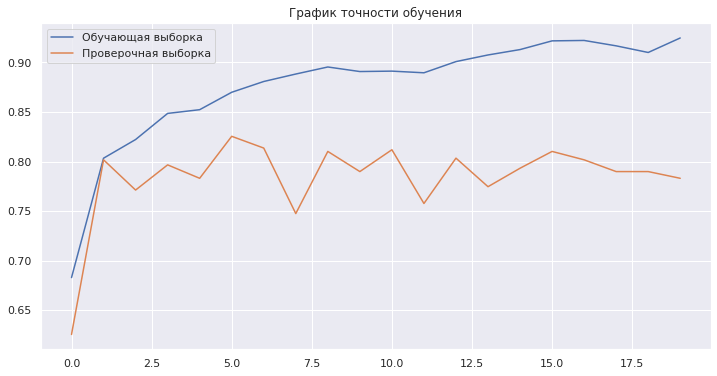

Тестрирование модели:   0%|                                                                                   …

1/1 [==============================] - 0s 18ms/step
Результат теста:
  * Количество отсчетов: 590
  * Правильных предсказаний: 480
  * Ошибочных предсказаний:  110

  * Точность предсказаний: 81.36%
Примеры распознавания

1/1 [==============================] - 0s 16ms/step
________________________________________
Тест №1
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2031.5
Цена через 1 интервал(а): 2034.7


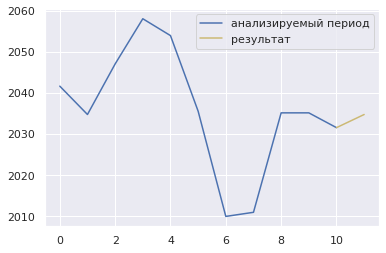

1/1 [==============================] - 0s 16ms/step
________________________________________
Тест №2
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2030.2
Цена через 1 интервал(а): 2015.9


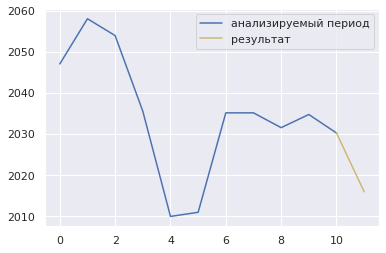

1/1 [==============================] - 0s 16ms/step
________________________________________
Тест №3
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2002.0
Цена через 1 интервал(а): 1978.5


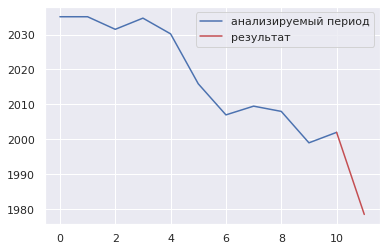

1/1 [==============================] - 0s 16ms/step
________________________________________
Тест №4
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2011.1
Цена через 1 интервал(а): 1980.1


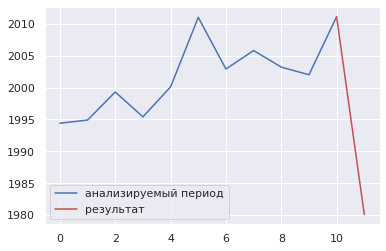

Производится симуляция торговой сессии
1/1 [==============================] - 0s 18ms/step
Стартовый капитал: 100000
Прирост после торгов: + 92801
Итого: 192801


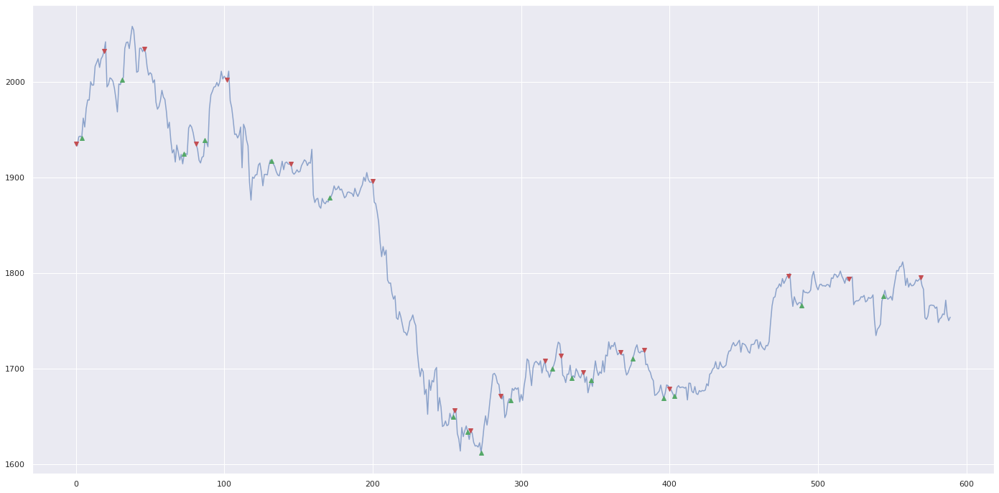

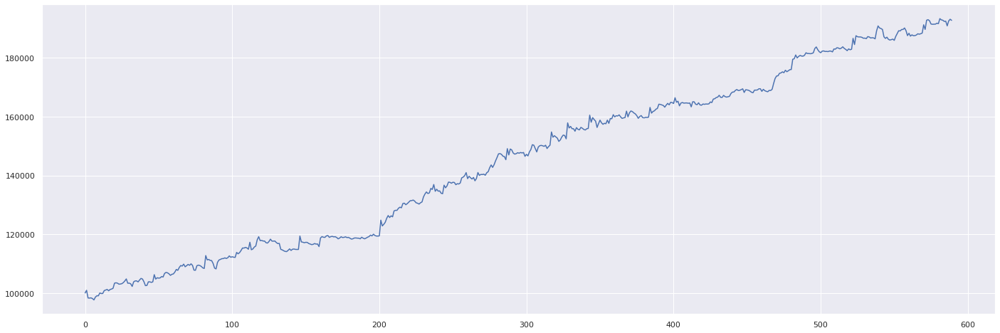

In [12]:
# Задание слоев нейронной сети
layers = f'Выравнивающий\
 Полносвязный-2000\
 Полносвязный-1500\
 Полносвязный-1000\
 Полносвязный-500\
 Полносвязный-250\
 Полносвязный-3'

# Создание модели нейронной сети
demo_ai.create_model(layers)

# Обучение нейронной сети
demo_ai.train_model(epochs=20)

# Демонстрация результата работы нейронной сети
demo_ai.test_model(    
    predict_period,
    days_for_analysis
    )

# Симуляция торговой сессии
demo_ai.traiding()

**Эксперимент №3**

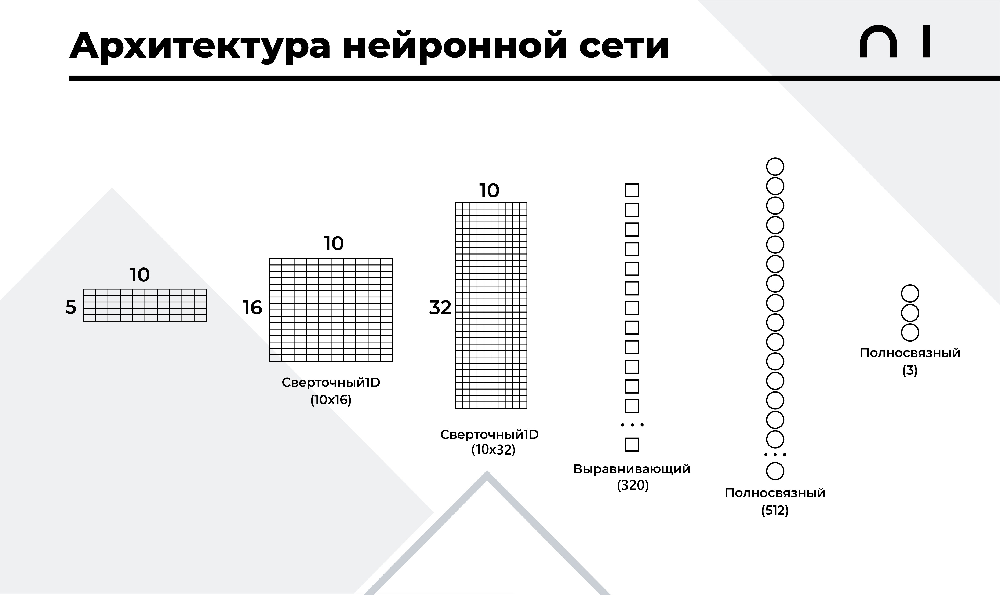

Эпоха №1    Время обучения: 7.22c   Точность на обучающей выборке: 68.08%    Точность на проверочной выборке: 68.98%
Эпоха №2    Время обучения: 0.17c   Точность на обучающей выборке: 78.62%    Точность на проверочной выборке: 75.93%
Эпоха №3    Время обучения: 0.17c   Точность на обучающей выборке: 82.47%    Точность на проверочной выборке: 78.14%
Эпоха №4    Время обучения: 0.17c   Точность на обучающей выборке: 84.1%     Точность на проверочной выборке: 78.98%
Эпоха №5    Время обучения: 0.19c   Точность на обучающей выборке: 85.69%    Точность на проверочной выборке: 81.02%
Эпоха №6    Время обучения: 0.17c   Точность на обучающей выборке: 87.66%    Точность на проверочной выборке: 79.32%
Эпоха №7    Время обучения: 0.17c   Точность на обучающей выборке: 88.45%    Точность на проверочной выборке: 79.32%
Эпоха №8    Время обучения: 0.16c   Точность на обучающей выборке: 89.29%    Точность на проверочной выборке: 79.49%
Эпоха №9    Время обучения: 0.19c   Точность на обучающей выборк

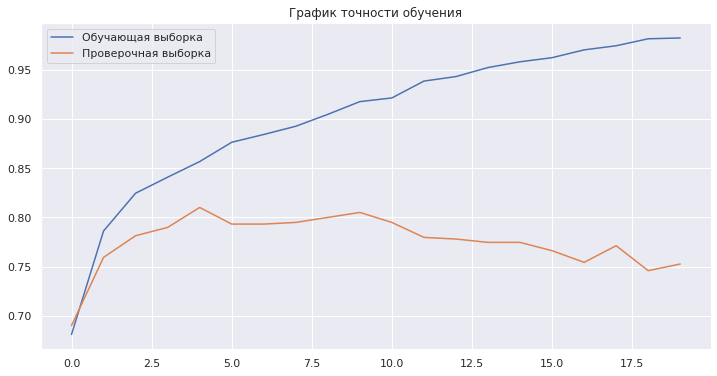

Тестрирование модели:   0%|                                                                                   …

1/1 [==============================] - 0s 19ms/step
Результат теста:
  * Количество отсчетов: 590
  * Правильных предсказаний: 472
  * Ошибочных предсказаний:  118

  * Точность предсказаний: 80.0%
Примеры распознавания

1/1 [==============================] - 0s 20ms/step
________________________________________
Тест №1
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2035.5
Цена через 1 интервал(а): 2009.9


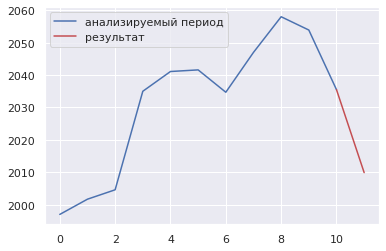

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №2
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2009.9
Цена через 1 интервал(а): 2010.9


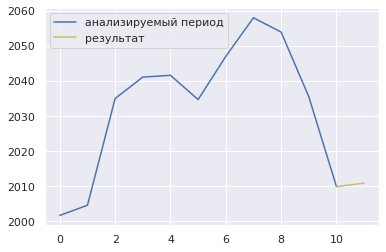

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №3
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2035.1
Цена через 1 интервал(а): 2031.5


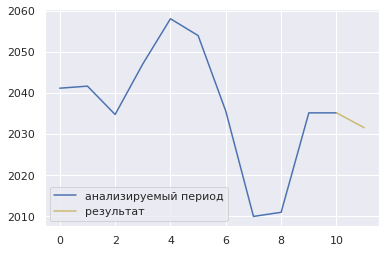

1/1 [==============================] - 0s 18ms/step
________________________________________
Тест №4
Модель предсказала: растущий тренд
Правильный ответ:  растущий тренд
Текущая цена:  1923.8
Цена через 1  интервал(а): 1951.5


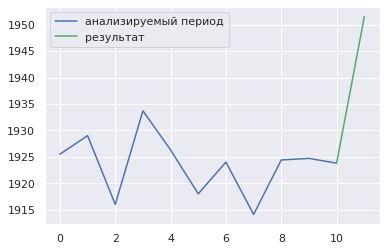

Производится симуляция торговой сессии
1/1 [==============================] - 0s 16ms/step
Стартовый капитал: 100000
Прирост после торгов: + 50809
Итого: 150809


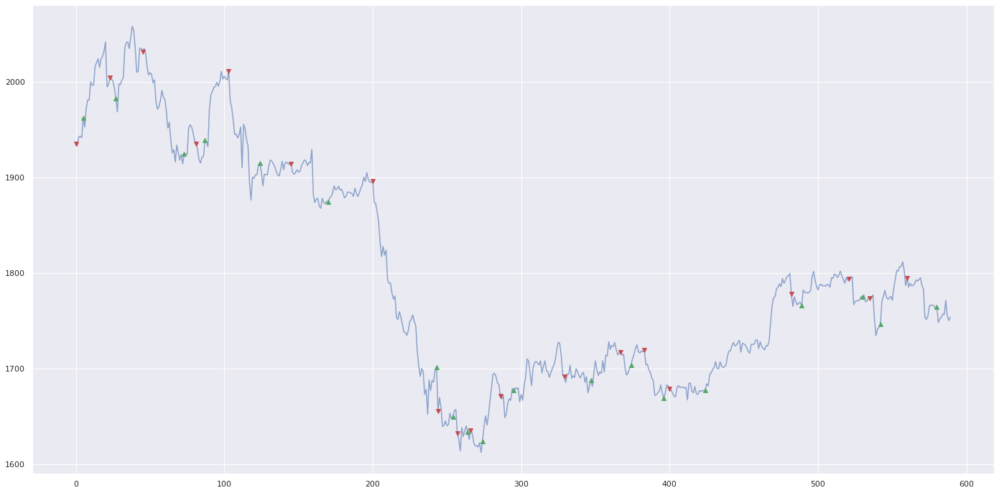

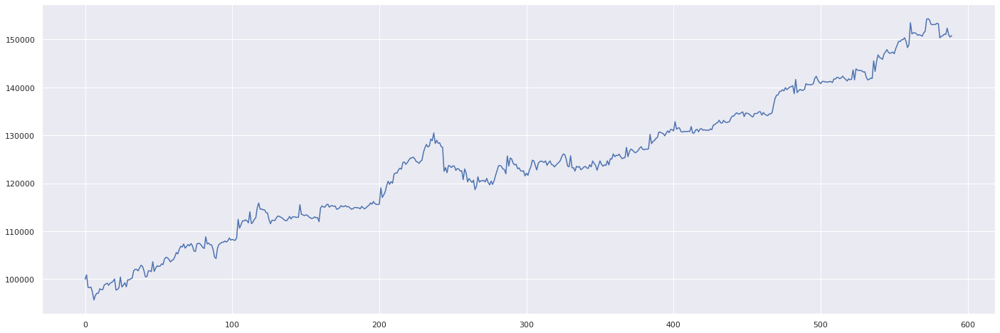

In [13]:
# Задание слоев нейронной сети
layers = f'Сверточный1D-16-5\
 Сверточный1D-32-5\
 Выравнивающий\
 Полносвязный-512\
 Полносвязный-3'

# Создание модели нейронной сети
demo_ai.create_model(layers)

# Обучение нейронной сети
demo_ai.train_model(epochs=20)

# Демонстрация результата работы нейронной сети
demo_ai.test_model(    
    predict_period,
    days_for_analysis
    )

# Симуляция торговой сессии
demo_ai.traiding()

## **Сегментация изображений (самолеты, люди)**

<h2><b> Сегментация самолетов </b></h2>

In [14]:
# Загрузка датасета
demo_ai.load_dataset('Самолеты')

Загрузка датасета Ok
Ифно:
    Вы скачали базу сегментированных изображений самолетов. База содержит 981 изображение


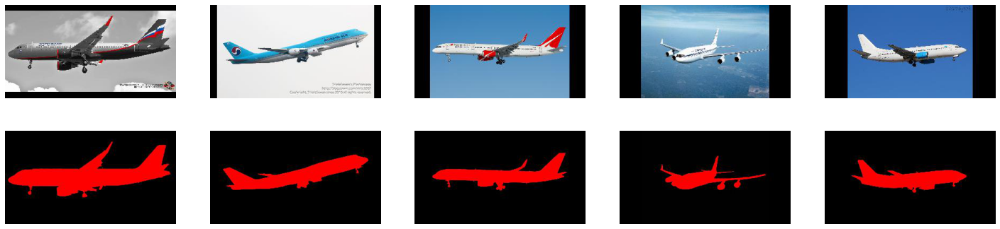

In [15]:
# Вывод примеров
demo_ai.samples()

In [16]:
# Создание обучающей и проверочной выборок
demo_ai.create_sets()

Самолеты original:   0%|                                                                                      …

Самолеты segment:   0%|                                                                                       …

Обработка изображений:   0%|                                                                                  …

Данные загружены. Обработано: 981 изображений
Время обработки:  156.13 c

Размер созданных выборок:
  Обучающая выборка: (882, 80, 160, 3)
  Метки обучающей выборки: (882, 80, 160, 2)
  Проверочная выборка: (99, 80, 160, 3)
  Метки проверочной выборки: (99, 80, 160, 2)



<h3><b>Исследования</b></h3>

**Эксперимент 1.1**

Модель: простая линейная сеть

In [17]:
# Задание слоев нейронной сети
layers = f'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3'

# Создание модели нейронной сети
demo_ai.create_model(layers)

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 3.21c   Точность на обучающей выборке: 74.23%    Точность на проверочной выборке: 83.08%
Эпоха №2    Время обучения: 0.72c   Точность на обучающей выборке: 84.43%    Точность на проверочной выборке: 85.87%
Эпоха №3    Время обучения: 0.73c   Точность на обучающей выборке: 87.69%    Точность на проверочной выборке: 88.18%
Эпоха №4    Время обучения: 0.7c    Точность на обучающей выборке: 90.04%    Точность на проверочной выборке: 89.39%
Эпоха №5    Время обучения: 0.69c   Точность на обучающей выборке: 91.23%    Точность на проверочной выборке: 90.53%
Эпоха №6    Время обучения: 0.7c    Точность на обучающей выборке: 91.56%    Точность на проверочной выборке: 91.69%
Эпоха №7    Время обучения: 0.7c    Точность на обучающей выборке: 92.1%     Точность на проверочной выборке: 92.23%
Эпоха №8    Время обучения: 0.7c    Точность на обучающей выборке: 92.26%    Точность на проверочной выборке: 92.26%
Эпоха №9    Время обучения: 0.7c    Точность на обучающей выборк

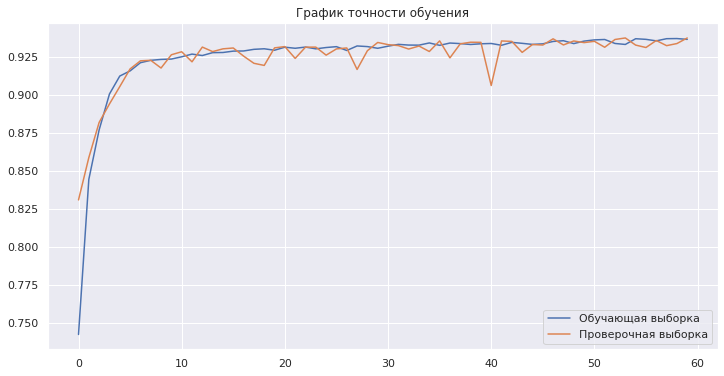

In [18]:
# Обучение нейронной сети
demo_ai.train_model(epochs=60)

1/1 [==============================] - 0s 15ms/step


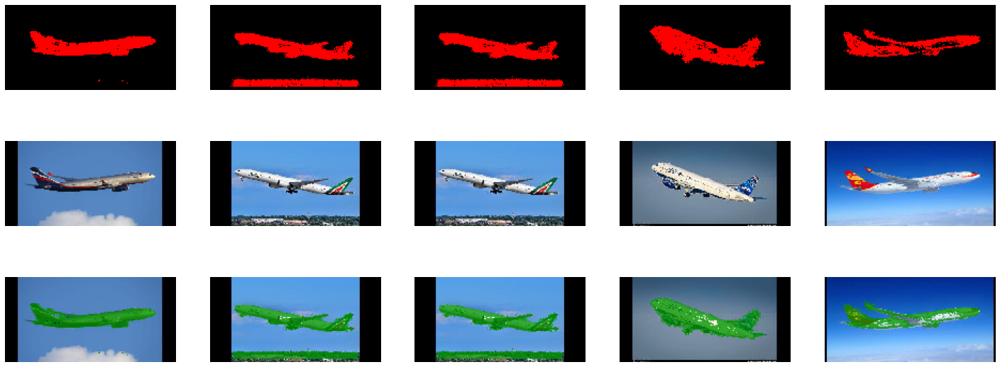

In [19]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 2.1**

Модель: PSP-NET

In [20]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
start_block = 'Сверточный2D-32-3\
 Сверточный2D-32-3'

PSP_block = 'Сверточный2D-32-3'

finally_block = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3'

# Создание модели нейронной сети
demo_ai.create_model(
    type_model='PSP',
    start_block = start_block, 
    PSP_block = PSP_block,
    finally_block = finally_block,    
    count_block = 2)

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 4.37c   Точность на обучающей выборке: 71.01%    Точность на проверочной выборке: 83.85%
Эпоха №2    Время обучения: 1.96c   Точность на обучающей выборке: 85.2%     Точность на проверочной выборке: 88.54%
Эпоха №3    Время обучения: 1.89c   Точность на обучающей выборке: 89.54%    Точность на проверочной выборке: 90.49%
Эпоха №4    Время обучения: 1.9c    Точность на обучающей выборке: 91.34%    Точность на проверочной выборке: 91.66%
Эпоха №5    Время обучения: 1.89c   Точность на обучающей выборке: 92.74%    Точность на проверочной выборке: 93.1%
Эпоха №6    Время обучения: 1.9c    Точность на обучающей выборке: 93.87%    Точность на проверочной выборке: 93.53%
Эпоха №7    Время обучения: 1.9c    Точность на обучающей выборке: 94.32%    Точность на проверочной выборке: 93.99%
Эпоха №8    Время обучения: 1.9c    Точность на обучающей выборке: 94.49%    Точность на проверочной выборке: 94.28%
Эпоха №9    Время обучения: 1.88c   Точность на обучающей выборке

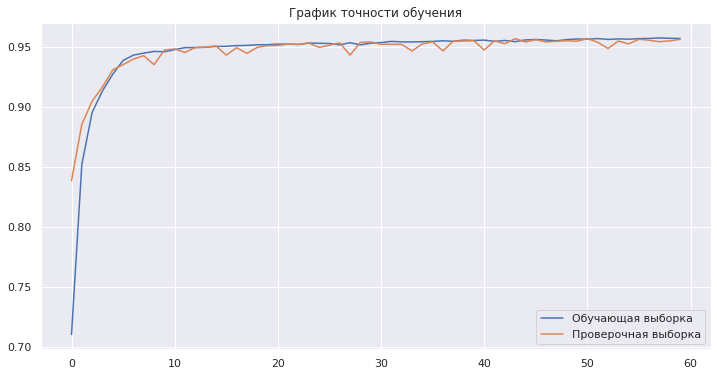

In [21]:
# Обучение нейронной сети
demo_ai.train_model(epochs=60)

1/1 [==============================] - 0s 17ms/step


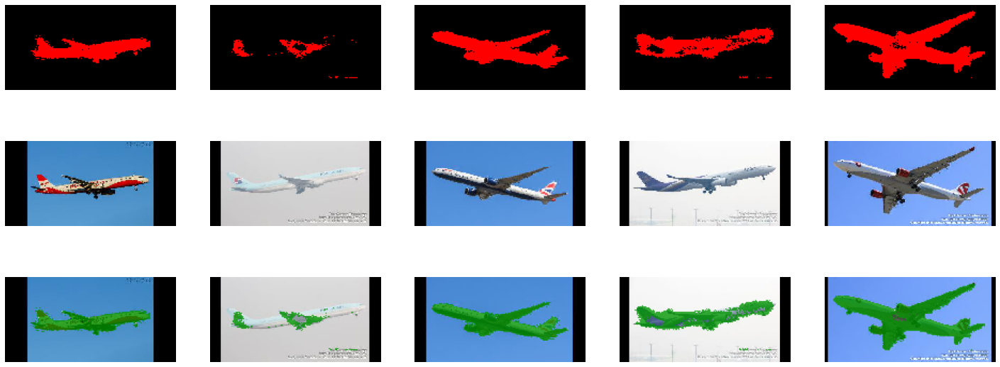

In [22]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 2.2**

Модель: PSP-NET

In [23]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
start_block = 'Сверточный2D-64-2\
 Сверточный2D-64-2'

PSP_block = 'Сверточный2D-64-2'

finally_block = 'Сверточный2D-64-2\
 Сверточный2D-64-2\
 Сверточный2D-2-2'

# Создание модели нейронной сети
demo_ai.create_model(
    type_model='PSP',
    start_block = start_block, 
    PSP_block = PSP_block,
    finally_block = finally_block,    
    count_block = 4)

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 9.65c   Точность на обучающей выборке: 81.01%    Точность на проверочной выборке: 85.12%
Эпоха №2    Время обучения: 5.29c   Точность на обучающей выборке: 89.04%    Точность на проверочной выборке: 89.73%
Эпоха №3    Время обучения: 5.3c    Точность на обучающей выборке: 91.13%    Точность на проверочной выборке: 91.54%
Эпоха №4    Время обучения: 5.3c    Точность на обучающей выборке: 92.16%    Точность на проверочной выборке: 92.57%
Эпоха №5    Время обучения: 5.3c    Точность на обучающей выборке: 93.02%    Точность на проверочной выборке: 92.71%
Эпоха №6    Время обучения: 5.3c    Точность на обучающей выборке: 93.83%    Точность на проверочной выборке: 93.48%
Эпоха №7    Время обучения: 5.31c   Точность на обучающей выборке: 94.19%    Точность на проверочной выборке: 94.07%
Эпоха №8    Время обучения: 5.3c    Точность на обучающей выборке: 94.38%    Точность на проверочной выборке: 94.33%
Эпоха №9    Время обучения: 5.36c   Точность на обучающей выборк

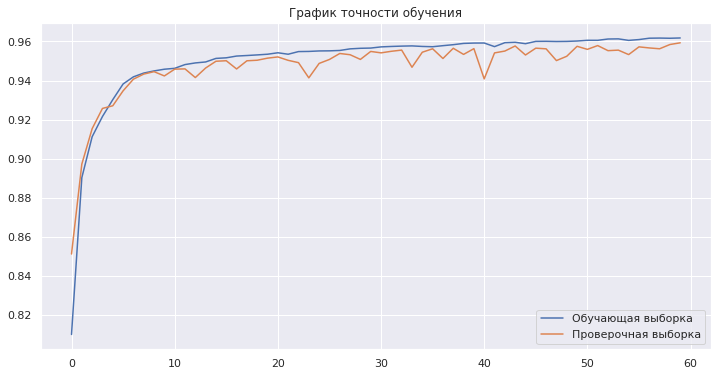

In [24]:
# Обучение нейронной сети
demo_ai.train_model(epochs=60)

1/1 [==============================] - 0s 24ms/step


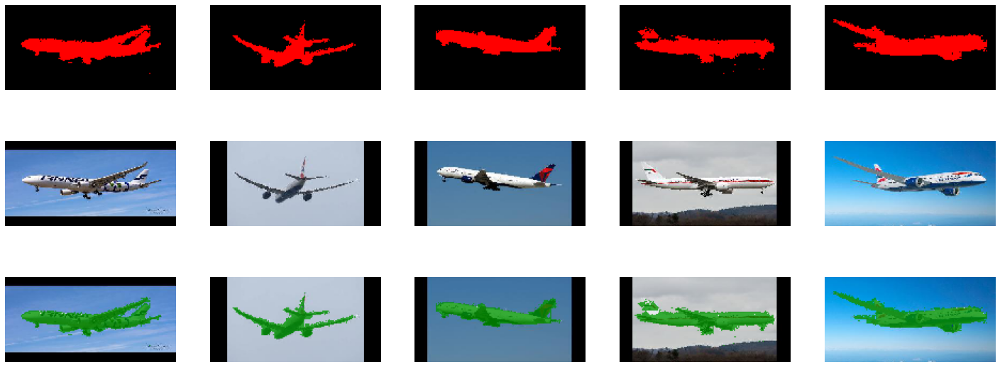

In [25]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 3.1**

Модель: U-net

In [26]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
down_block_1 = 'Сверточный2D-32-3 Сверточный2D-32-3'
down_block_2 = 'Сверточный2D-64-3 Сверточный2D-64-3'

bottom_block   =  'Сверточный2D-128-3 Сверточный2D-128-3'

up_block_1 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
up_block_2 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'


# Создание модели нейронной сети
demo_ai.create_model(
    type_model='U-net',
    down_blcoks = [down_block_1, down_block_2],
    bottom_block = bottom_block, 
    up_blocks = [up_block_1, up_block_2],
    )

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 6.77c   Точность на обучающей выборке: 78.09%    Точность на проверочной выборке: 81.32%
Эпоха №2    Время обучения: 2.77c   Точность на обучающей выборке: 88.18%    Точность на проверочной выборке: 91.14%
Эпоха №3    Время обучения: 2.78c   Точность на обучающей выборке: 92.72%    Точность на проверочной выборке: 93.04%
Эпоха №4    Время обучения: 2.78c   Точность на обучающей выборке: 93.86%    Точность на проверочной выборке: 94.15%
Эпоха №5    Время обучения: 2.78c   Точность на обучающей выборке: 94.39%    Точность на проверочной выборке: 94.61%
Эпоха №6    Время обучения: 2.78c   Точность на обучающей выборке: 94.62%    Точность на проверочной выборке: 94.28%
Эпоха №7    Время обучения: 2.79c   Точность на обучающей выборке: 95.06%    Точность на проверочной выборке: 94.8%
Эпоха №8    Время обучения: 2.76c   Точность на обучающей выборке: 95.13%    Точность на проверочной выборке: 95.06%
Эпоха №9    Время обучения: 2.8c    Точность на обучающей выборке

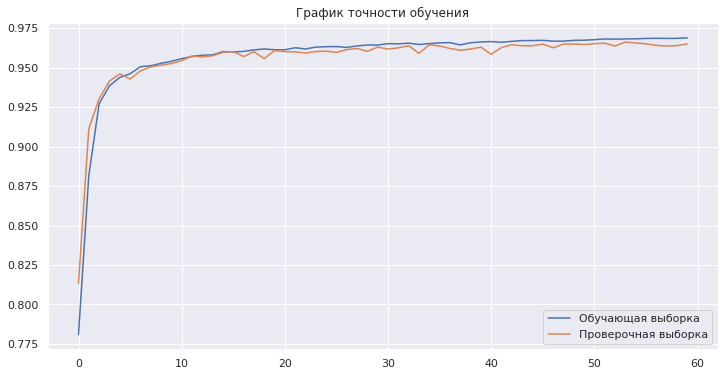

In [27]:
# Обучение нейронной сети
demo_ai.train_model(epochs=60)

1/1 [==============================] - 0s 16ms/step


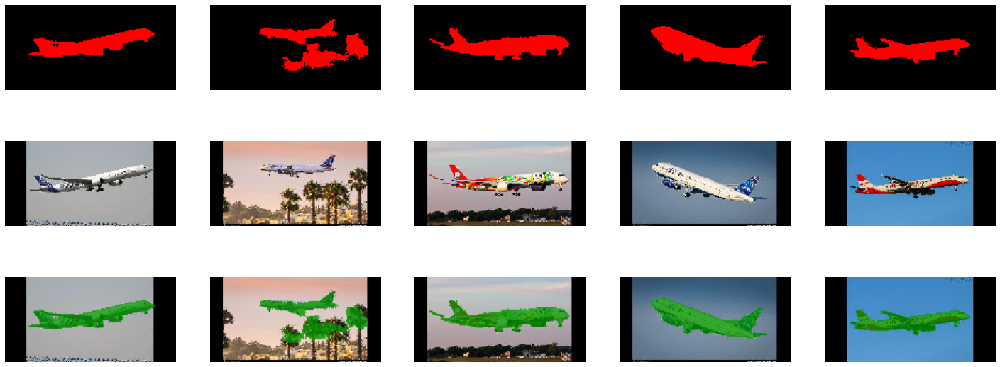

In [28]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 3.2**

Модель: U-Net

In [29]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
down_block_1 = 'Сверточный2D-32-3 Сверточный2D-32-3'
down_block_2 = 'Сверточный2D-64-3 Сверточный2D-64-3'
down_block_3  =  'Сверточный2D-128-3 Сверточный2D-128-3'

bottom_block   =  'Сверточный2D-256-3 Сверточный2D-256-3'

up_block_1 =  'Объединение Сверточный2D-128-3 Сверточный2D-128-3'
up_block_2 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
up_block_3 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'


# Создание модели нейронной сети
demo_ai.create_model(
    type_model='U-net',
    down_blcoks = [down_block_1, down_block_2, down_block_2],
    bottom_block = bottom_block, 
    up_blocks = [up_block_1, up_block_2, up_block_3],
    )

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 9.08c   Точность на обучающей выборке: 82.22%    Точность на проверочной выборке: 90.44%
Эпоха №2    Время обучения: 3.76c   Точность на обучающей выборке: 93.14%    Точность на проверочной выборке: 93.6%
Эпоха №3    Время обучения: 3.73c   Точность на обучающей выборке: 94.58%    Точность на проверочной выборке: 94.94%
Эпоха №4    Время обучения: 3.78c   Точность на обучающей выборке: 95.13%    Точность на проверочной выборке: 95.17%
Эпоха №5    Время обучения: 3.8c    Точность на обучающей выборке: 95.29%    Точность на проверочной выборке: 95.47%
Эпоха №6    Время обучения: 3.74c   Точность на обучающей выборке: 95.42%    Точность на проверочной выборке: 94.78%
Эпоха №7    Время обучения: 3.79c   Точность на обучающей выборке: 95.63%    Точность на проверочной выборке: 95.24%
Эпоха №8    Время обучения: 3.75c   Точность на обучающей выборке: 95.71%    Точность на проверочной выборке: 95.7%
Эпоха №9    Время обучения: 3.98c   Точность на обучающей выборке:

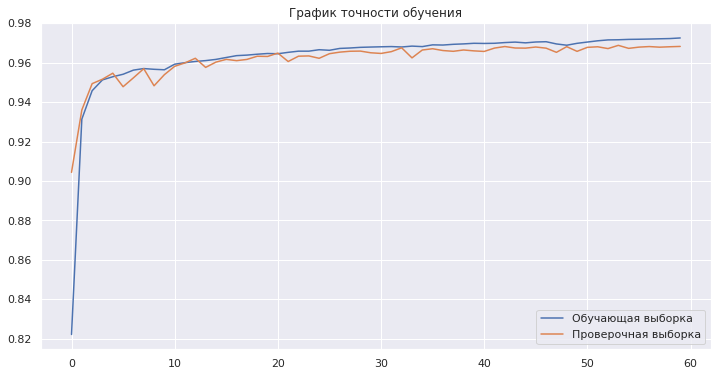

In [30]:
# Обучение нейронной сети
demo_ai.train_model(epochs=60)

1/1 [==============================] - 0s 17ms/step


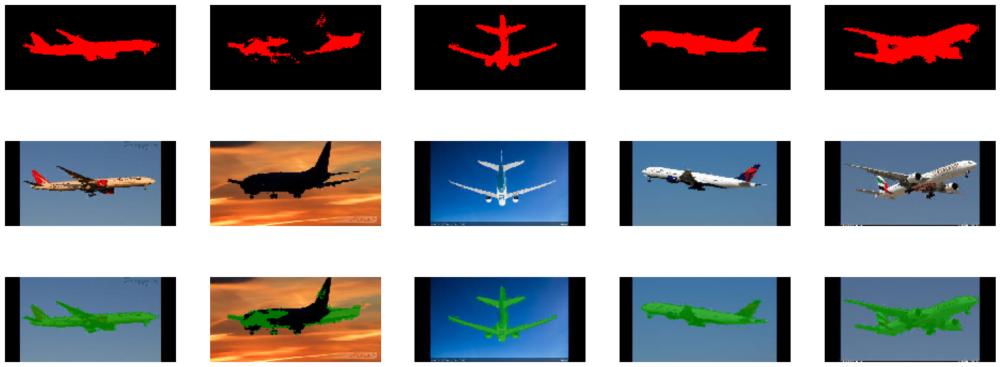

In [31]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

<h2><b>Модель на изображениях 320х160 px</b></h2>

In [32]:
# Загрузка датасета
demo_ai.load_dataset('Самолеты_макс')

Загрузка датасета Ok
Ифно:
    Вы скачали базу сегментированных изображений самолетов. База содержит 981 изображение


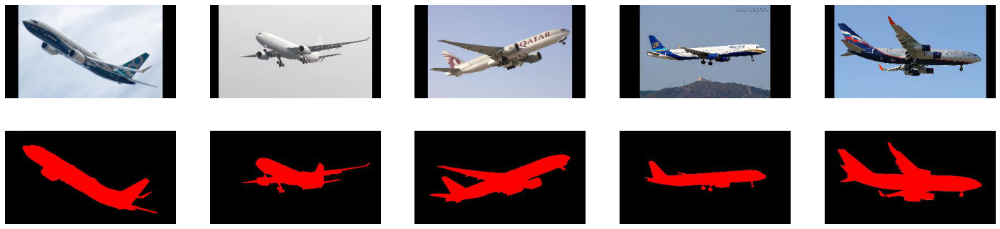

In [33]:
demo_ai.samples()

In [34]:
# Создание обучающей и проверочной выборок
demo_ai.create_sets()

Самолеты original:   0%|                                                                                      …

Самолеты segment:   0%|                                                                                       …

Обработка изображений:   0%|                                                                                  …

Данные загружены. Обработано: 981 изображений
Время обработки:  584.54 c

Размер созданных выборок:
  Обучающая выборка: (882, 160, 320, 3)
  Метки обучающей выборки: (882, 160, 320, 2)
  Проверочная выборка: (99, 160, 320, 3)
  Метки проверочной выборки: (99, 160, 320, 2)



In [35]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
down_block_1 = 'Сверточный2D-32-3 Сверточный2D-32-3'
down_block_2 = 'Сверточный2D-64-3 Сверточный2D-64-3'
down_block_3  =  'Сверточный2D-128-3 Сверточный2D-128-3'

bottom_block   =  'Сверточный2D-256-3 Сверточный2D-256-3'

up_block_1 =  'Объединение Сверточный2D-128-3 Сверточный2D-128-3'
up_block_2 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
up_block_3 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'


# Создание модели нейронной сети
demo_ai.create_model(
    type_model='U-net',
    down_blcoks = [down_block_1, down_block_2, down_block_2],
    bottom_block = bottom_block, 
    up_blocks = [up_block_1, up_block_2, up_block_3],
    )

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 27.56c  Точность на обучающей выборке: 78.3%     Точность на проверочной выборке: 89.95%
Эпоха №2    Время обучения: 14.38c  Точность на обучающей выборке: 88.96%    Точность на проверочной выборке: 91.64%
Эпоха №3    Время обучения: 14.52c  Точность на обучающей выборке: 91.98%    Точность на проверочной выборке: 93.91%
Эпоха №4    Время обучения: 14.62c  Точность на обучающей выборке: 94.33%    Точность на проверочной выборке: 93.77%
Эпоха №5    Время обучения: 14.76c  Точность на обучающей выборке: 94.82%    Точность на проверочной выборке: 94.69%
Эпоха №6    Время обучения: 14.76c  Точность на обучающей выборке: 95.19%    Точность на проверочной выборке: 95.64%
Эпоха №7    Время обучения: 14.75c  Точность на обучающей выборке: 95.36%    Точность на проверочной выборке: 95.28%
Эпоха №8    Время обучения: 14.94c  Точность на обучающей выборке: 95.52%    Точность на проверочной выборке: 95.36%
Эпоха №9    Время обучения: 15.12c  Точность на обучающей выборк

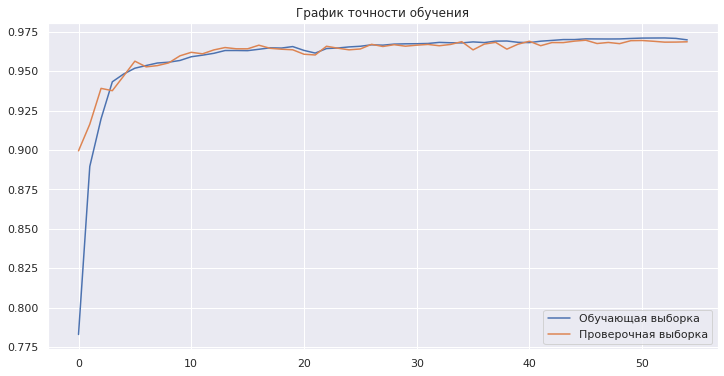

In [36]:
# Обучение нейронной сети
demo_ai.train_model(epochs=55)

1/1 [==============================] - 0s 18ms/step


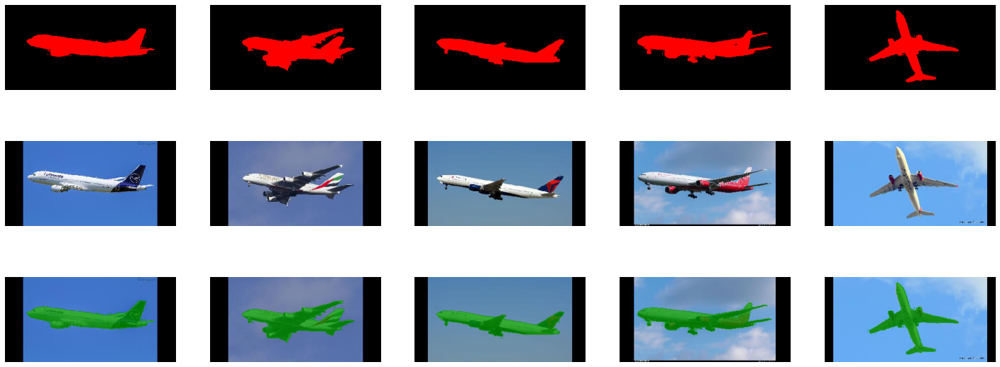

In [37]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

<h2><b> Сегментация людей </b></h2>

In [38]:
# Загрузка датасета
demo_ai.load_dataset('Люди')

Загрузка датасета Ok
Ифно:
    Вы скачали базу сегментированных изображений людей. База содержит 1500 изображение


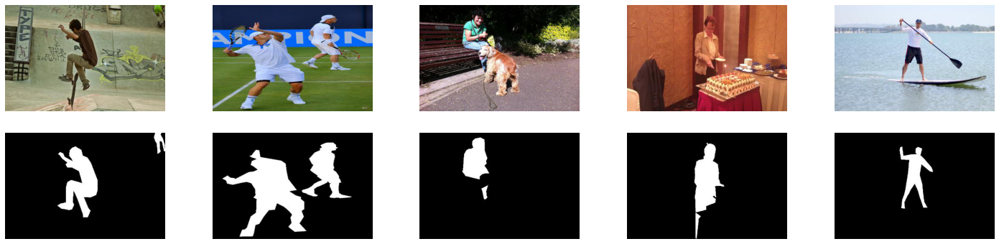

In [39]:
demo_ai.samples()

In [40]:
# Создание обучающей и проверочной выборок
demo_ai.create_sets()

Люди original:   0%|                                                                                          …

Люди segment:   0%|                                                                                           …

Обработка изображений:   0%|                                                                                  …

Данные загружены. Обработано: 1500 изображений
Время обработки:  236.81 c

Размер созданных выборок:
  Обучающая выборка: (1350, 80, 160, 3)
  Метки обучающей выборки: (1350, 80, 160, 2)
  Проверочная выборка: (150, 80, 160, 3)
  Метки проверочной выборки: (150, 80, 160, 2)



<h3><b>Исследования</b></h3>

**Эксперимент №1.1**

Модель: простая линейная сеть

Эпоха №1    Время обучения: 2.11c   Точность на обучающей выборке: 73.17%    Точность на проверочной выборке: 69.03%
Эпоха №2    Время обучения: 1.05c   Точность на обучающей выборке: 73.75%    Точность на проверочной выборке: 70.18%
Эпоха №3    Время обучения: 1.05c   Точность на обучающей выборке: 74.24%    Точность на проверочной выборке: 76.18%
Эпоха №4    Время обучения: 1.06c   Точность на обучающей выборке: 74.18%    Точность на проверочной выборке: 74.2%
Эпоха №5    Время обучения: 1.06c   Точность на обучающей выборке: 74.2%     Точность на проверочной выборке: 73.04%
Эпоха №6    Время обучения: 1.05c   Точность на обучающей выборке: 74.19%    Точность на проверочной выборке: 74.44%
Эпоха №7    Время обучения: 1.05c   Точность на обучающей выборке: 74.32%    Точность на проверочной выборке: 70.64%
Эпоха №8    Время обучения: 1.05c   Точность на обучающей выборке: 74.38%    Точность на проверочной выборке: 77.04%
Эпоха №9    Время обучения: 1.05c   Точность на обучающей выборке

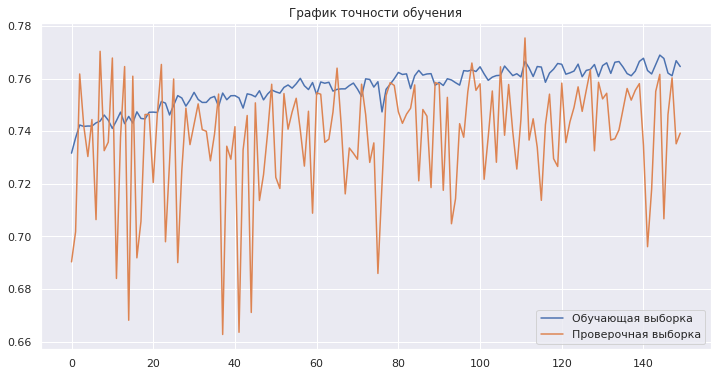

1/1 [==============================] - 0s 18ms/step


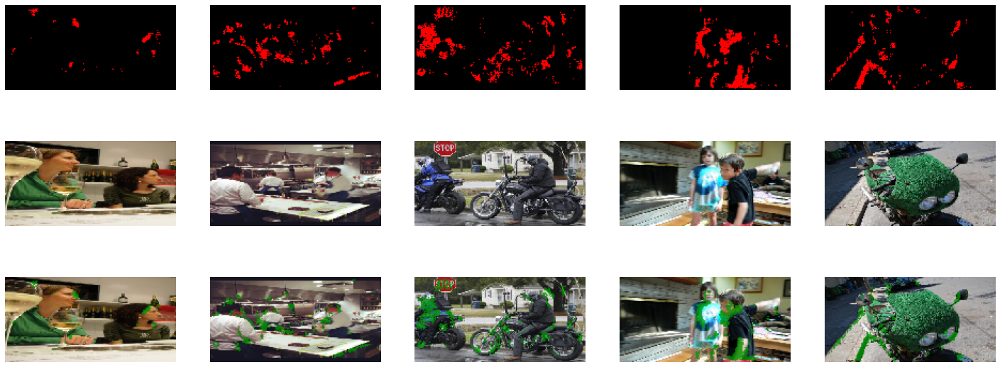

In [41]:
# Задание слоев нейронной сети
layers = f'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3'

# Создание модели нейронной сети
demo_ai.create_model(layers)

# Обучение нейронной сети
demo_ai.train_model(epochs=150)

# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 2.1**

Модель: PSP-NET

In [42]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
start_block = 'Сверточный2D-32-3\
 Сверточный2D-32-3'

PSP_block = 'Сверточный2D-32-3'

finally_block = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3'

# Создание модели нейронной сети
demo_ai.create_model(
    type_model='PSP',
    start_block = start_block, 
    PSP_block = PSP_block,
    finally_block = finally_block,    
    count_block = 2)

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 4.77c   Точность на обучающей выборке: 72.74%    Точность на проверочной выборке: 71.76%
Эпоха №2    Время обучения: 2.88c   Точность на обучающей выборке: 73.8%     Точность на проверочной выборке: 75.84%
Эпоха №3    Время обучения: 2.89c   Точность на обучающей выборке: 74.29%    Точность на проверочной выборке: 76.28%
Эпоха №4    Время обучения: 2.88c   Точность на обучающей выборке: 74.52%    Точность на проверочной выборке: 73.43%
Эпоха №5    Время обучения: 2.87c   Точность на обучающей выборке: 74.57%    Точность на проверочной выборке: 76.09%
Эпоха №6    Время обучения: 2.87c   Точность на обучающей выборке: 74.81%    Точность на проверочной выборке: 76.35%
Эпоха №7    Время обучения: 2.9c    Точность на обучающей выборке: 74.82%    Точность на проверочной выборке: 75.8%
Эпоха №8    Время обучения: 2.91c   Точность на обучающей выборке: 75.11%    Точность на проверочной выборке: 74.48%
Эпоха №9    Время обучения: 2.9c    Точность на обучающей выборке

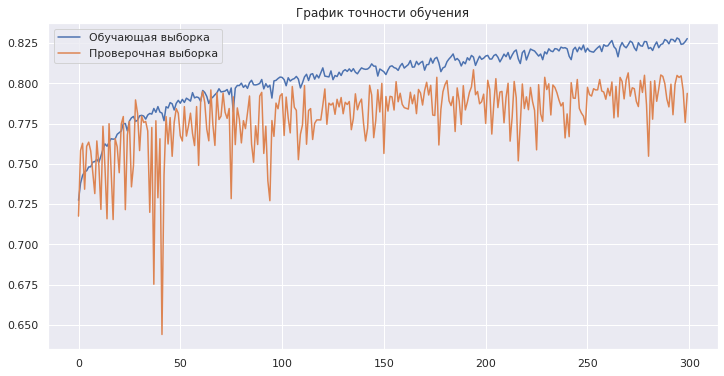

In [43]:
# Обучение нейронной сети
demo_ai.train_model(epochs=300)

1/1 [==============================] - 0s 17ms/step


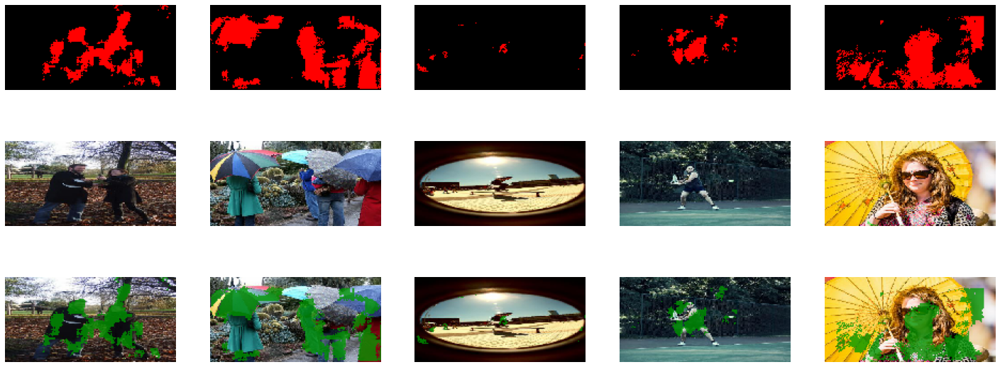

In [44]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 2.2**

Модель: PSP-NET

In [45]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
start_block = 'Сверточный2D-64-2\
 Сверточный2D-64-2'

PSP_block = 'Сверточный2D-64-2'

finally_block = 'Сверточный2D-64-2\
 Сверточный2D-64-2\
 Сверточный2D-2-2'

# Создание модели нейронной сети
demo_ai.create_model(
    type_model='PSP',
    start_block = start_block, 
    PSP_block = PSP_block,
    finally_block = finally_block,    
    count_block = 4)

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 10.68c  Точность на обучающей выборке: 72.56%    Точность на проверочной выборке: 68.05%
Эпоха №2    Время обучения: 8.07c   Точность на обучающей выборке: 74.13%    Точность на проверочной выборке: 75.28%
Эпоха №3    Время обучения: 8.06c   Точность на обучающей выборке: 74.28%    Точность на проверочной выборке: 77.64%
Эпоха №4    Время обучения: 8.16c   Точность на обучающей выборке: 75.17%    Точность на проверочной выборке: 75.85%
Эпоха №5    Время обучения: 8.16c   Точность на обучающей выборке: 75.6%     Точность на проверочной выборке: 77.49%
Эпоха №6    Время обучения: 8.17c   Точность на обучающей выборке: 76.23%    Точность на проверочной выборке: 73.58%
Эпоха №7    Время обучения: 8.48c   Точность на обучающей выборке: 76.37%    Точность на проверочной выборке: 76.39%
Эпоха №8    Время обучения: 8.18c   Точность на обучающей выборке: 76.26%    Точность на проверочной выборке: 77.15%
Эпоха №9    Время обучения: 8.22c   Точность на обучающей выборк

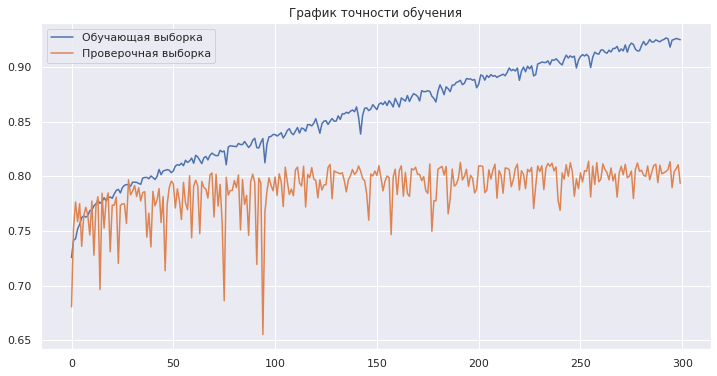

In [46]:
# Обучение нейронной сети
demo_ai.train_model(epochs=300)

1/1 [==============================] - 0s 19ms/step


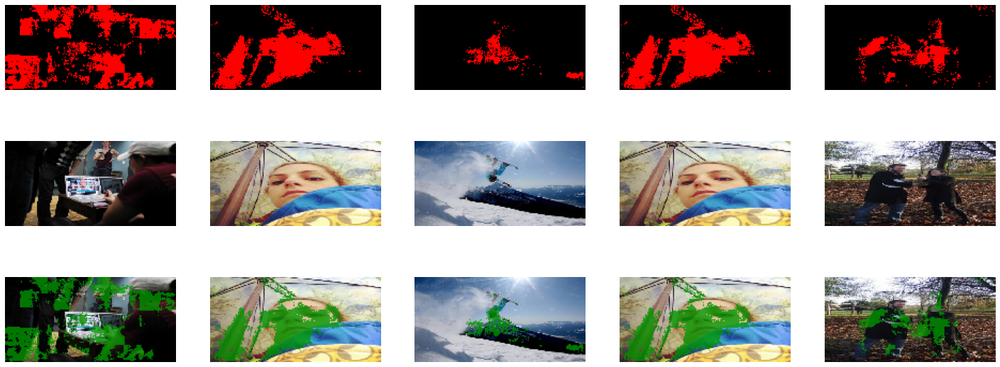

In [47]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 3.1**

Модель: U-net

In [48]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
down_block_1 = 'Сверточный2D-32-3 Сверточный2D-32-3'
down_block_2 = 'Сверточный2D-64-3 Сверточный2D-64-3'

bottom_block   =  'Сверточный2D-128-3 Сверточный2D-128-3'

up_block_1 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
up_block_2 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'


# Создание модели нейронной сети
demo_ai.create_model(
    type_model='U-net',
    down_blcoks = [down_block_1, down_block_2],
    bottom_block = bottom_block, 
    up_blocks = [up_block_1, up_block_2],
    )

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 6.82c   Точность на обучающей выборке: 71.18%    Точность на проверочной выборке: 70.41%
Эпоха №2    Время обучения: 4.37c   Точность на обучающей выборке: 72.73%    Точность на проверочной выборке: 71.14%
Эпоха №3    Время обучения: 4.38c   Точность на обучающей выборке: 73.74%    Точность на проверочной выборке: 72.96%
Эпоха №4    Время обучения: 4.38c   Точность на обучающей выборке: 74.98%    Точность на проверочной выборке: 75.97%
Эпоха №5    Время обучения: 4.52c   Точность на обучающей выборке: 75.32%    Точность на проверочной выборке: 75.86%
Эпоха №6    Время обучения: 4.34c   Точность на обучающей выборке: 75.9%     Точность на проверочной выборке: 77.56%
Эпоха №7    Время обучения: 4.34c   Точность на обучающей выборке: 76.74%    Точность на проверочной выборке: 76.97%
Эпоха №8    Время обучения: 4.37c   Точность на обучающей выборке: 77.4%     Точность на проверочной выборке: 76.86%
Эпоха №9    Время обучения: 4.38c   Точность на обучающей выборк

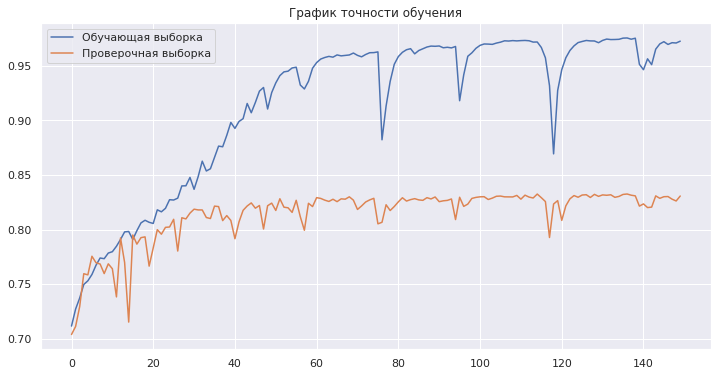

In [49]:
# Обучение нейронной сети
demo_ai.train_model(epochs=150)

1/1 [==============================] - 0s 17ms/step


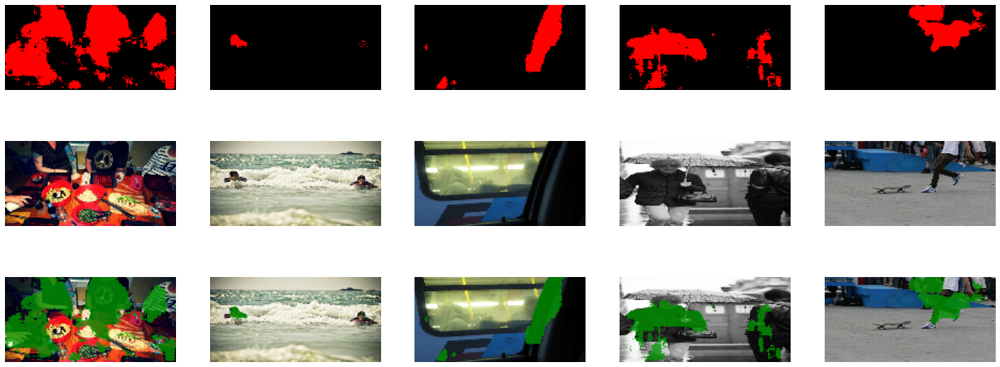

In [50]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

**Эксперимент 3.2**

Модель: U-Net (лучшая модель)

In [51]:
# Задание слоев нейронной сети
# Указываем слои создаваемой модели
down_block_1 = 'Сверточный2D-32-3 Сверточный2D-32-3'
down_block_2 = 'Сверточный2D-64-3 Сверточный2D-64-3'
down_block_3  =  'Сверточный2D-128-3 Сверточный2D-128-3'

bottom_block   =  'Сверточный2D-256-3 Сверточный2D-256-3'

up_block_1 =  'Объединение Сверточный2D-128-3 Сверточный2D-128-3'
up_block_2 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
up_block_3 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'


# Создание модели нейронной сети
demo_ai.create_model(
    type_model='U-net',
    down_blcoks = [down_block_1, down_block_2, down_block_2],
    bottom_block = bottom_block, 
    up_blocks = [up_block_1, up_block_2, up_block_3],
    )

Создание модели нейронной сети Ok


Эпоха №1    Время обучения: 9.35c   Точность на обучающей выборке: 70.53%    Точность на проверочной выборке: 72.01%
Эпоха №2    Время обучения: 5.85c   Точность на обучающей выборке: 72.53%    Точность на проверочной выборке: 71.44%
Эпоха №3    Время обучения: 5.8c    Точность на обучающей выборке: 73.54%    Точность на проверочной выборке: 76.1%
Эпоха №4    Время обучения: 5.86c   Точность на обучающей выборке: 74.61%    Точность на проверочной выборке: 72.02%
Эпоха №5    Время обучения: 5.86c   Точность на обучающей выборке: 75.5%     Точность на проверочной выборке: 75.14%
Эпоха №6    Время обучения: 5.95c   Точность на обучающей выборке: 76.82%    Точность на проверочной выборке: 74.65%
Эпоха №7    Время обучения: 5.8c    Точность на обучающей выборке: 76.62%    Точность на проверочной выборке: 78.22%
Эпоха №8    Время обучения: 5.85c   Точность на обучающей выборке: 77.35%    Точность на проверочной выборке: 75.24%
Эпоха №9    Время обучения: 5.81c   Точность на обучающей выборке

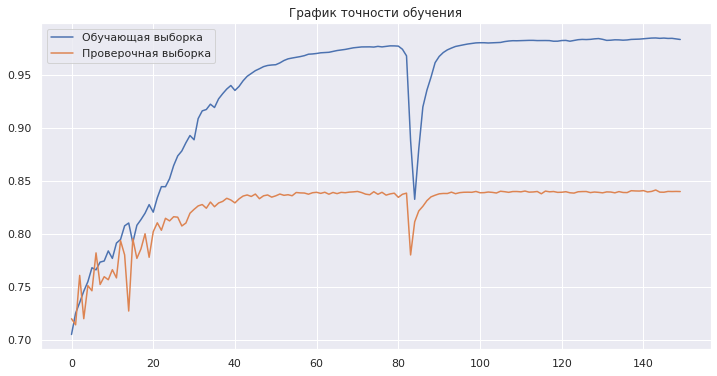

In [52]:
# Обучение нейронной сети
demo_ai.train_model(epochs=150)

1/1 [==============================] - 0s 18ms/step


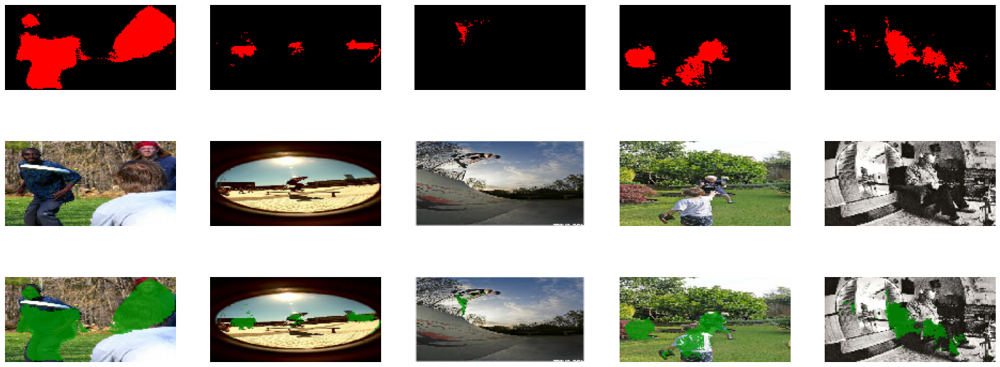

In [53]:
# Демонстрация результата работы нейронной сети
demo_ai.test_model()

## **Распознавание голосовых команд для умного дома**

In [54]:
# Загрузка датасета
demo_ai.load_dataset('Умный_дом')

Загрузка датасета Ok
Ифно:
    Вы скачали базу аудиоданных с командами для умного дома. База содержит 4 класса: «Кондиционер», «Свет», «Телевизор», «Фоновая речь»


Пример голосовой команды «Кондиционер»:


Спектр голосовой команды:


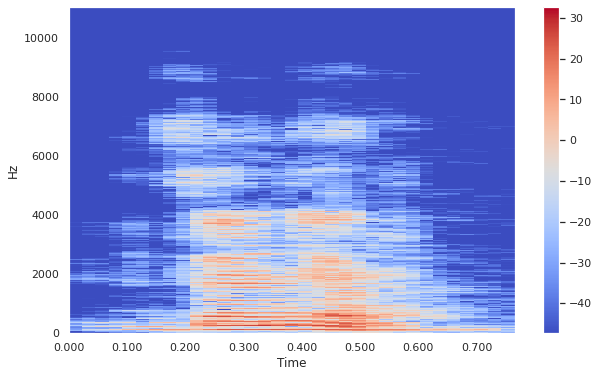

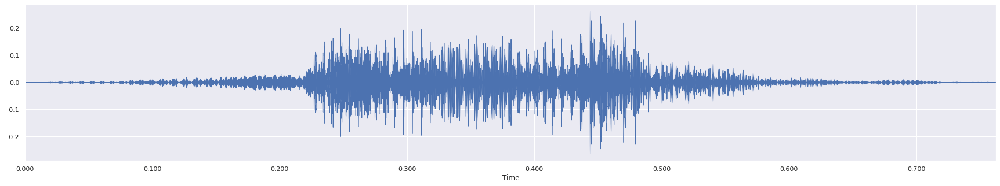



Пример голосовой команды «Свет»:


Спектр голосовой команды:


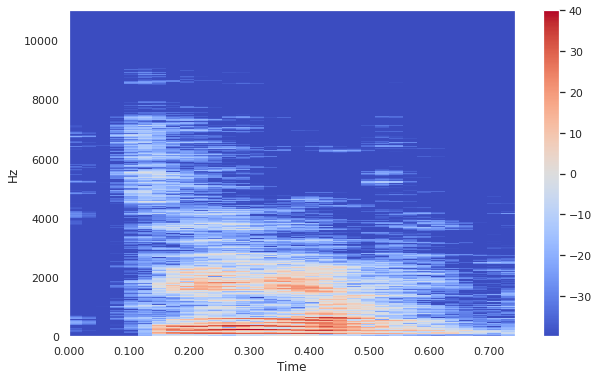

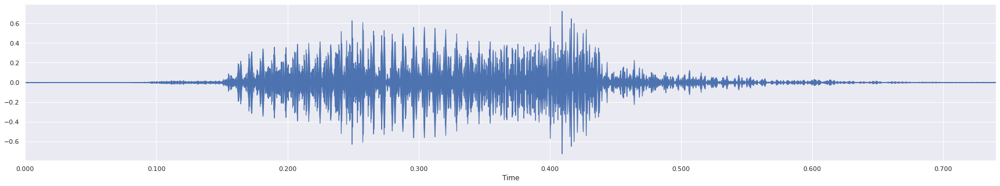



Пример голосовой команды «Телевизор»:


Спектр голосовой команды:


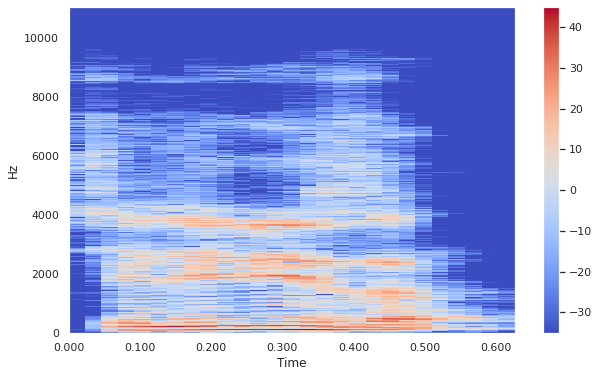

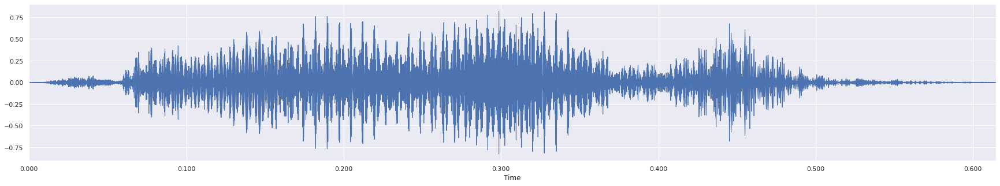



Пример голосовой команды «Фон»:


Спектр голосовой команды:


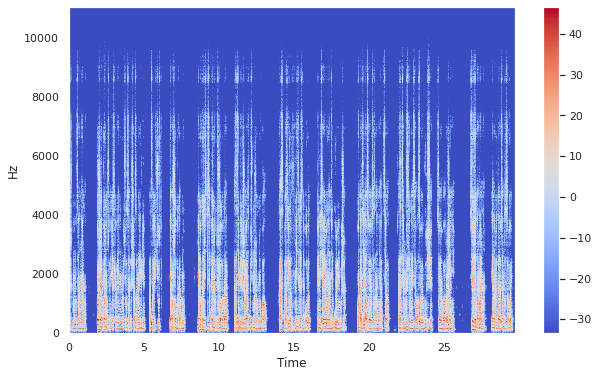

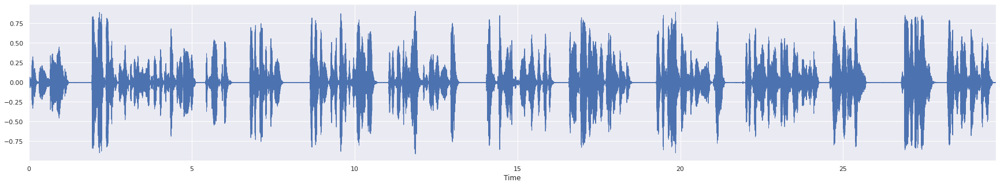

In [55]:
# Вывод примеров
demo_ai.samples()

Команда: кондиционер
Исходное аудио: 


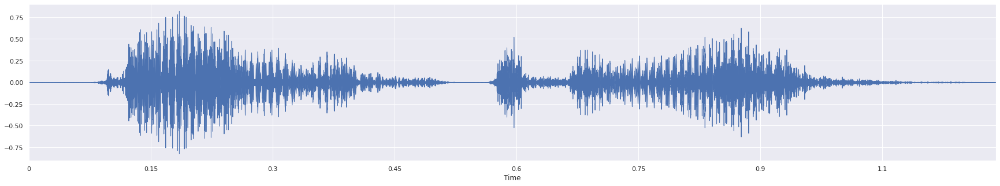



Спектр сигнала:


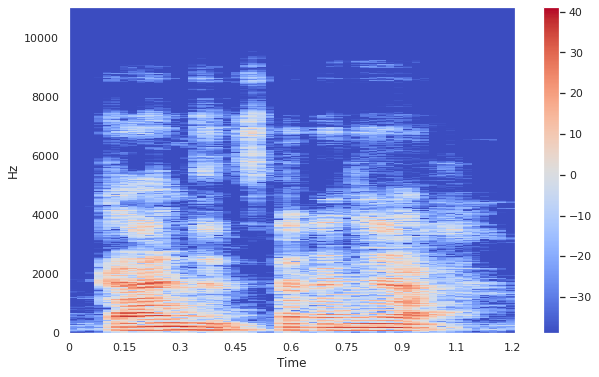

In [56]:
# Показать пример параметризации аудио-файла 
# Параметр файл может принимать одно из значений: кондиционер, свет, телевизор, фон
demo_ai.samples(category = 'кондиционер')

Сохраняем векторы класса 1_cond:   0%|                                                                        …

Сохраняем векторы класса 2_light:   0%|                                                                       …

Сохраняем векторы класса 3_tv:   0%|                                                                          …

Сохраняем векторы класса 4_noise:   0%|                                                                       …


Данные успешно загружены. Обработано: 391 аудио

Время обработки: 4 мин 55.11 c

Размер созданных выборок:
  Обучающая выборка: (32286, 20, 22, 1)
  Метки обучающей выборки: (32286, 4)
  Проверочная выборка: (8072, 20, 22, 1)
  Метки проверочной выборки: (8072, 4)
Распределение по классам:


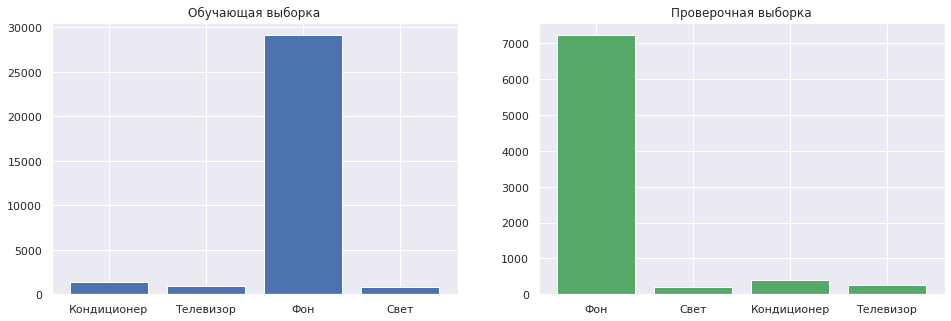

In [57]:
# Создание обучающей и проверочной выборок

block_length = 0.5 # Длину аудио_отрезка
block_step = 0.04  # Шаг

demo_ai.create_sets(
    block_length,
    block_step,
    )

In [58]:
# Задание слоев нейронной сети
layers = f'Сверточный2D-8-2\
 Выравнивающий\
 Полносвязный-128\
 Полносвязный-64\
 Полносвязный-4'

# Создание модели нейронной сети
demo_ai.create_model(layers)

# Создание модели нейронной сети
demo_ai.create_model(layers)

Создание модели нейронной сети Ok
Создание модели нейронной сети Ok


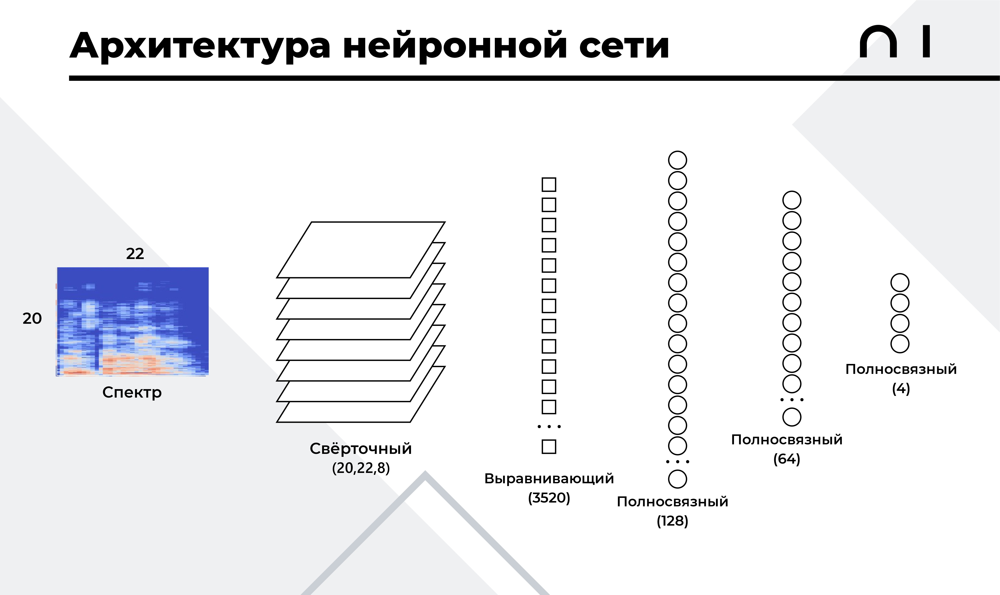

Эпоха №1    Время обучения: 1.63c   Точность на обучающей выборке: 96.07%    Точность на проверочной выборке: 98.59%
Эпоха №2    Время обучения: 0.99c   Точность на обучающей выборке: 98.67%    Точность на проверочной выборке: 99.23%
Эпоха №3    Время обучения: 0.98c   Точность на обучающей выборке: 99.26%    Точность на проверочной выборке: 99.32%
Эпоха №4    Время обучения: 0.99c   Точность на обучающей выборке: 99.35%    Точность на проверочной выборке: 99.28%
Эпоха №5    Время обучения: 0.96c   Точность на обучающей выборке: 99.48%    Точность на проверочной выборке: 99.44%
Эпоха №6    Время обучения: 0.97c   Точность на обучающей выборке: 99.69%    Точность на проверочной выборке: 99.5%
Эпоха №7    Время обучения: 0.98c   Точность на обучающей выборке: 99.73%    Точность на проверочной выборке: 99.6%
Эпоха №8    Время обучения: 0.99c   Точность на обучающей выборке: 99.62%    Точность на проверочной выборке: 99.6%
Эпоха №9    Время обучения: 0.96c   Точность на обучающей выборке: 

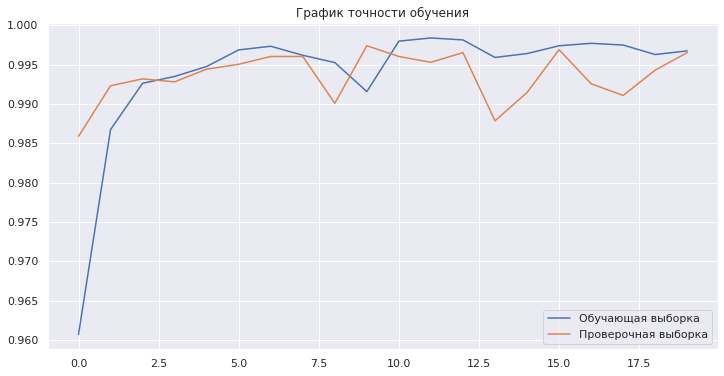

In [59]:
# Обучение нейронной сети
demo_ai.train_model(epochs=20)

Исходное аудио для проверки работы нейронной сети: 



46/46 [==============================] - 0s 2ms/step
Распознана команда: " ТЕЛЕВИЗОР " (вероятность - 99.08 %)


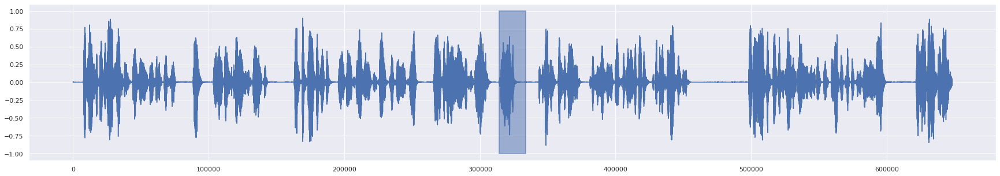

In [60]:
# Демонстрация результата работы нейронной сети
filter=0.95

demo_ai.test_model(
    filter,
    block_length,
    block_step
)

Исходное аудио для проверки работы нейронной сети: 



47/47 [==============================] - 0s 3ms/step
Распознана команда: " СВЕТ " (вероятность - 97.61 %)


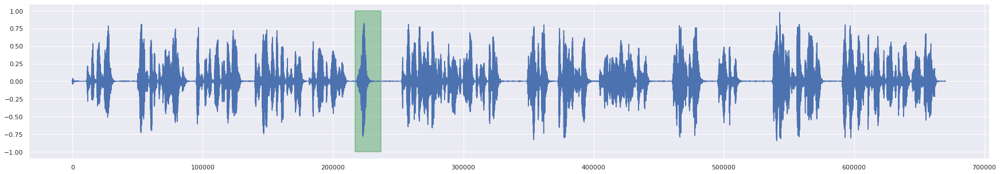

In [61]:
# Демонстрация результата работы нейронной сети
filter=0.95

demo_ai.test_model(
    filter,
    block_length,
    block_step
)

Исходное аудио для проверки работы нейронной сети: 



45/45 [==============================] - 0s 3ms/step
Распознана команда: " ТЕЛЕВИЗОР " (вероятность - 99.12 %)


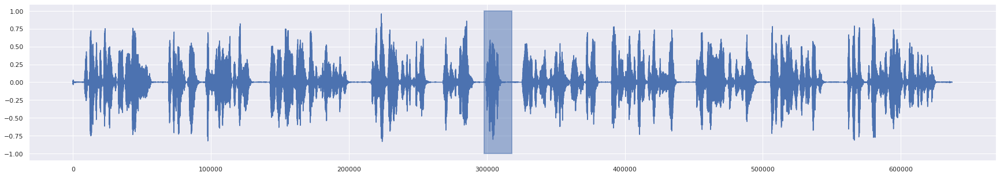

In [62]:
# Демонстрация результата работы нейронной сети
filter=0.95

demo_ai.test_model(
    filter,
    block_length,
    block_step
)